In [1]:
#! pip install opencv-python

## Los ejercicios que deben agregarse a este proyecto serán las siguientes:

- 1. Investiga e implementa el método tile-based histogram equalization. En estos métodos, la imagen se particiona en diferentes ventanas (i.e. mosaicos) y los histogramas se calculan de forma independiente, aplicando la corrección sobre cada ventana. Existe un compromiso entre el tamaño de la ventana y la complejidad computacional, por lo cual es más complejo que el método simple. Implementa esta versión y realiza algunas pruebas variando el tamaño de la ventana. Otro inconveniente es que se puede observar posibles diferencias entre los el contraste de los bloques, ¿cómo podría mejorarse?
- 2. Investiga e implementa un método sencillo del Sliding Window Adaptive Histogram Equalization (SWAHE) y compara algunas imágenes con diferentes tipos de imágenes.
- 3. Investiga cómo funciona el algoritmo CLAHE (contrast limited adaptive histogram equalization) y realiza una implementación (puede ser usando la implementación de OpenCV). Prueba sobre diferentes tipos de imágenes y compara con el método de ecualización de histogramas básico. Provee una breve descripción del método a partir de una  investigación bibliográfica.

In [2]:
#Import of libraries
from IPython.display import display
from PIL import Image

import matplotlib.pyplot as plt
import numpy as np
import cv2

- 1. Investiga e implementa el método tile-based histogram equalization. En estos métodos, la imagen se particiona en diferentes ventanas (i.e. mosaicos) y los histogramas se calculan de forma independiente, aplicando la corrección sobre cada ventana. Existe un compromiso entre el tamaño de la ventana y la complejidad computacional, por lo cual es más complejo que el método simple. Implementa esta versión y realiza algunas pruebas variando el tamaño de la ventana. Otro inconveniente es que se puede observar posibles diferencias entre los el contraste de los bloques, ¿cómo podría mejorarse?

Image size: 14971392
Image shape: (1824, 2736, 3)


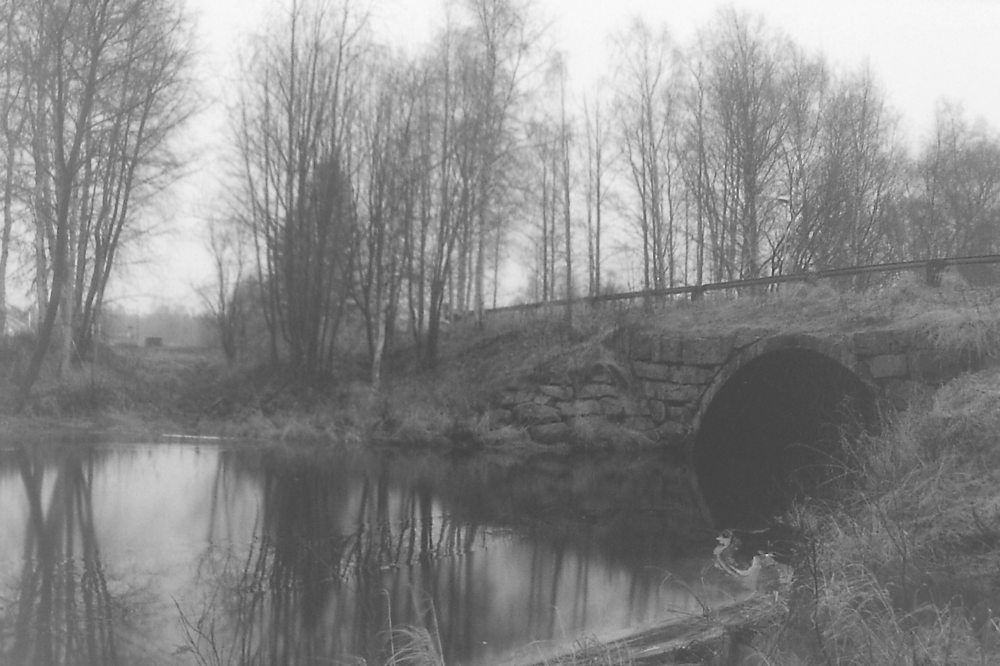

In [3]:
#Importing the original image
path = "assets/low-contrast.png"
#spath = "assets/low.webp"
#path = "assets/low-contrast0.jpg"
#path = "assets/low-contrast2.jpeg"
img = cv2.imread(path)
print(f'Image size: {img.size}')
print(f'Image shape: {img.shape}')
display(Image.fromarray(img))

In [4]:
#Function that adjusts the contrast of the image
def tile_based_histogram_equalizatio(tile_size=8, clip_limit=2):
    #Create a CLASS object (arguments are optional).
    clahe = cv2.createCLAHE (clipLimit=clip_limit, tileGridSize=(tile_size, tile_size))
    gray_image = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    cl1 = clahe.apply(gray_image)

    #stacking images side-by-side
    res = np.hstack((gray_image, cl1))

    #Show picture
    display(Image.fromarray(res))

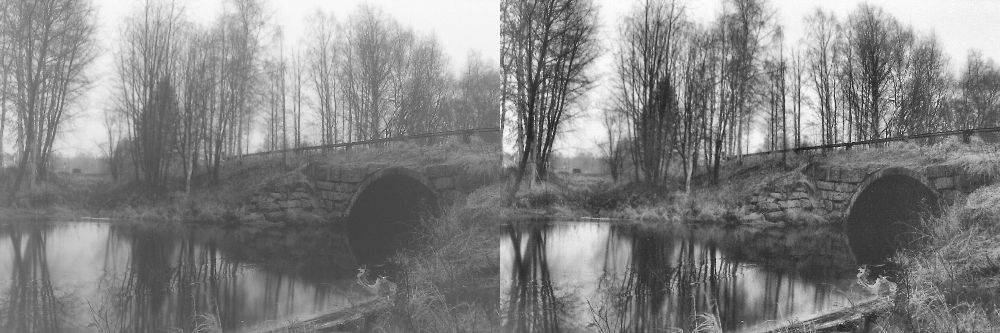

In [5]:
#Create a CLASS object (arguments are optional).
tile_size = 8 #Tile size
tile_based_histogram_equalizatio(tile_size)

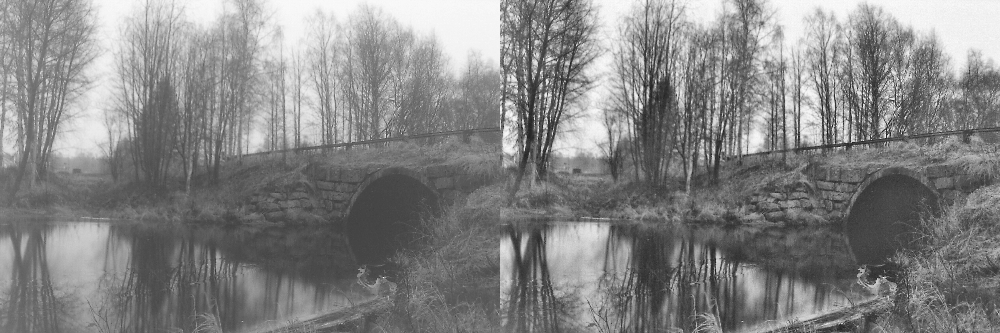

In [6]:
#Create a CLASS object (arguments are optional).
tile_size = 16 #Tile size
tile_based_histogram_equalizatio(tile_size)

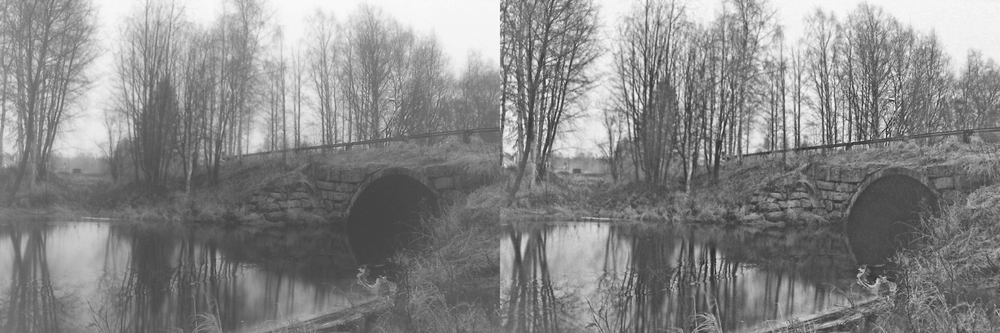

In [7]:
#Create a CLASS object (arguments are optional).
tile_size = 50 #Tile size
tile_based_histogram_equalizatio(tile_size)

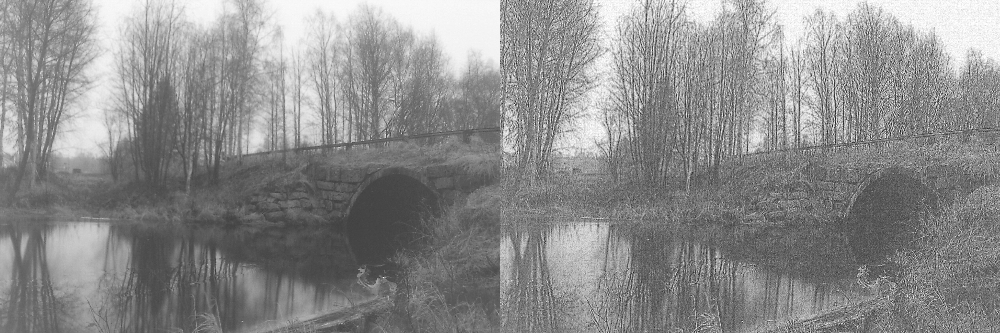

In [8]:
#Create a CLASS object (arguments are optional).
tile_size = 500 #Tile size
tile_based_histogram_equalizatio(tile_size)

In [31]:
#Function that adjusts the contrast of the image
def tile_based_histogram_equalizatio(tile_size=8, clip_limit=2):
    #Create a CLASS object (arguments are optional).
    clahe = cv2.createCLAHE (clipLimit=clip_limit, tileGridSize=(tile_size, tile_size))
    gray_image = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    return clahe.apply(gray_image)

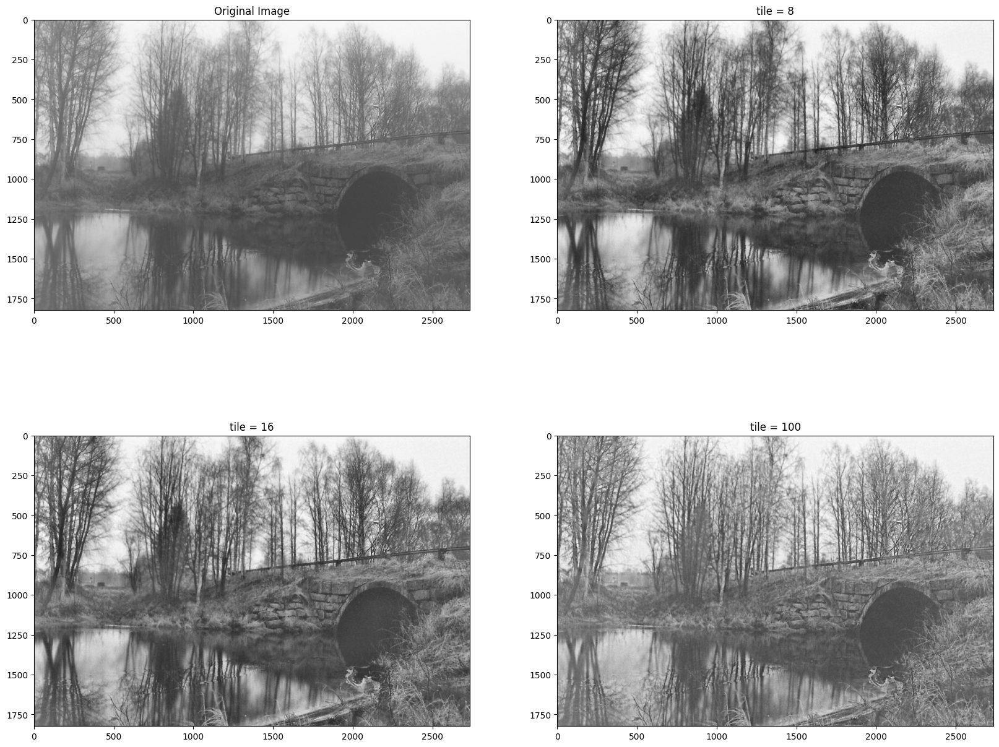

In [33]:
res1 = tile_based_histogram_equalizatio(8)
res2 = tile_based_histogram_equalizatio(16)
res3 = tile_based_histogram_equalizatio(100)

fig = plt.figure(figsize=(20, 16))

plt.subplot(221),plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))
plt.title('Original Image')

plt.subplot(222),plt.imshow(cv2.cvtColor(res1, cv2.COLOR_BGR2RGB))
plt.title('tile = 8')

plt.subplot(223),plt.imshow(cv2.cvtColor(res2, cv2.COLOR_BGR2RGB))
plt.title('tile = 16')

plt.subplot(224),plt.imshow(cv2.cvtColor(res3, cv2.COLOR_BGR2RGB))
plt.title('tile = 100')

plt.show()

Tomando un límite de contraste, y al variar el tamaño de ventanas en el proceso se muestra que al tener un tile de 8 el contraste de la imagen mejora y a partir de ello el tamaño a 16 sigue estando bien pero no mejor al anterior, al subir el tamaño el contraste se desajusta de forma que provoca un efecto diferente en la imagen que no hace que el paisaje sea mas claro o que sus detalles se puedan mostrar, pero dependiendo la imagen es la necesidad del ajuste que deberá tener.

Otro inconveniente es que se puede observar posibles diferencias entre los El contraste de los bloques, ¿cómo podría mejorarse?
Esto se puede derivar al ruido existente en cada ventana ya que este mismo se amplifica mostrando estas diferencias, para ello se puede aplicar el limite de contraste. Si algún bin de histograma esta por encima del limite estipulado esos pixeles se recortarán y distribuirán uniformemente a otros bins antes de aplicar la ecualización de histograma. Después de esto, para eliminar los artefactos en los bordes de los mosaicos, se aplica la interpolación bilineal.